<a href="https://colab.research.google.com/github/dhsingh0815/ML/blob/main/Classifier/Classifier_HeartRatePredictionDataSet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [40]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from math import log2
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import  RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.tree import export_graphviz
from IPython.display import Image
import pydotplus

In [41]:
df = pd.read_csv('/content/Heartattack_prediction_data.csv')

In [42]:
df.head(5)

,Sex,Age,Heart Rate,Glucose,BMI,Smoker,Ciggarates(Per Day),Hypertension,Systolic BP,Diastolic BP,ON BP Medication,Previous Stroke,Diabetic,RiskOfCHD
0,1,39,80.0,77.0,26.97,0,0.0,0,106.0,70.0,0.0,0,0,0
1,0,46,95.0,76.0,28.73,0,0.0,0,121.0,81.0,0.0,0,0,0
2,1,48,75.0,70.0,25.34,1,20.0,0,127.5,80.0,0.0,0,0,0
3,0,61,65.0,103.0,28.58,1,30.0,1,150.0,95.0,0.0,0,0,1
4,0,46,85.0,85.0,23.10,1,23.0,0,130.0,84.0,0.0,0,0,0


In [43]:
df.shape

(4312, 14)

In [44]:
df.isnull().sum()

,0
Sex,0
Age,0
Heart Rate,1
Glucose,200
BMI,19
Smoker,0
Ciggarates(Per Day),29
Hypertension,0
Systolic BP,0
Diastolic BP,0


In [45]:
df.isna().sum()

,0
Sex,0
Age,0
Heart Rate,1
Glucose,200
BMI,19
Smoker,0
Ciggarates(Per Day),29
Hypertension,0
Systolic BP,0
Diastolic BP,0


In [46]:
df.dropna(inplace=True)

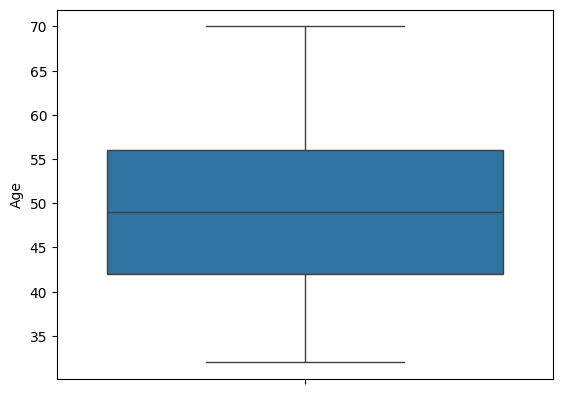

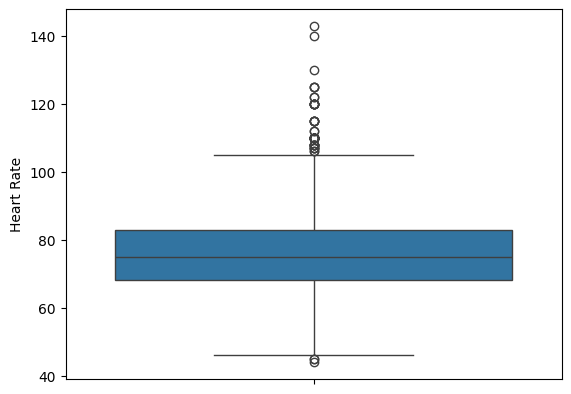

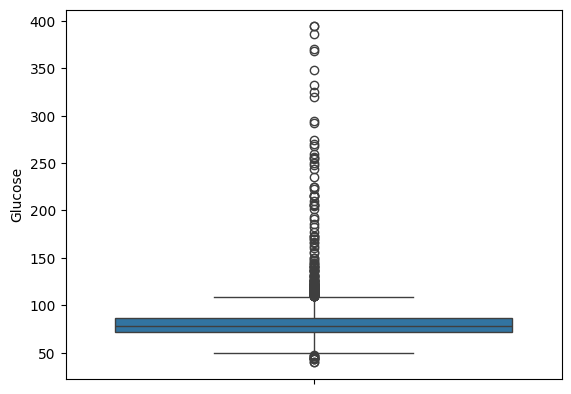

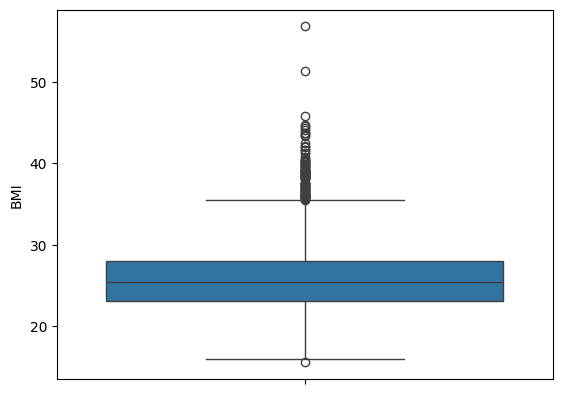

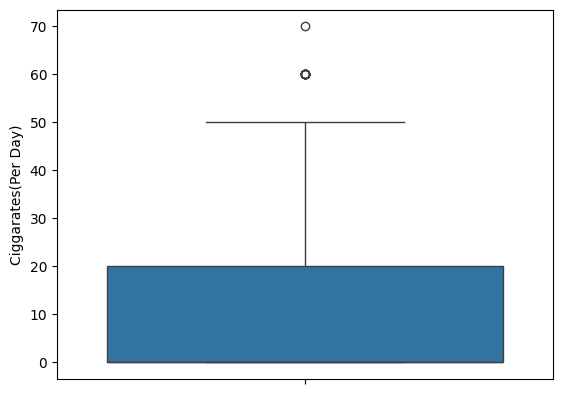

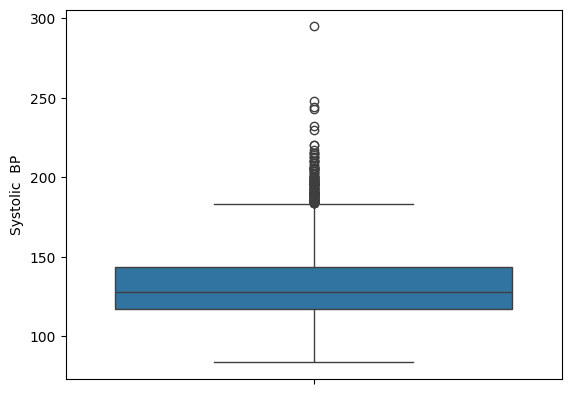

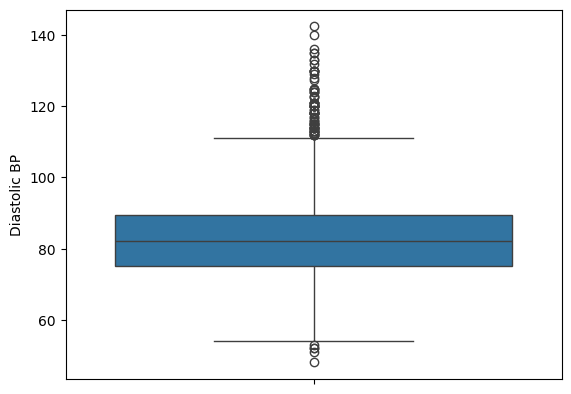

In [47]:
cols = df.columns
for col in cols:
  if(df[col].value_counts().size>2):
    sns.boxplot(df[col])
    plt.show()

Remove outliers from Heart Rate, Glucose , BMI BP readings

In [48]:
def remove_outliers(data_frame, series_col):
 Q1 = np.percentile(series_col, 25)
 Q3 = np.percentile(series_col, 75)
 IQR = Q3 - Q1
 Lower_Limit = Q1 - 1.5 * IQR
 Upper_Limit = Q3 + 1.5 * IQR
 Upper_Limit = Q3 + 1.5 * IQR
 data_frame = data_frame[(series_col >Lower_Limit) & (series_col < Upper_Limit)]
 return data_frame

In [49]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4017 entries, 0 to 4311
Data columns (total 14 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Sex                  4017 non-null   int64  
 1   Age                  4017 non-null   int64  
 2   Heart Rate           4017 non-null   float64
 3   Glucose              4017 non-null   float64
 4   BMI                  4017 non-null   float64
 5   Smoker               4017 non-null   int64  
 6   Ciggarates(Per Day)  4017 non-null   float64
 7   Hypertension         4017 non-null   int64  
 8   Systolic  BP         4017 non-null   float64
 9   Diastolic BP         4017 non-null   float64
 10  ON BP Medication     4017 non-null   float64
 11  Previous Stroke      4017 non-null   int64  
 12  Diabetic             4017 non-null   int64  
 13  RiskOfCHD            4017 non-null   int64  
dtypes: float64(7), int64(7)
memory usage: 470.7 KB


In [50]:
df[['RiskOfCHD']].value_counts()

,count
RiskOfCHD,
0,3405
1,612


In [51]:
df=remove_outliers(df,df['Heart Rate'])
df=remove_outliers(df,df['BMI'])
df=remove_outliers(df,df['Glucose'])

df=remove_outliers(df,df['Diastolic BP'])
df=remove_outliers(df,df['Systolic  BP'])

<Axes: >

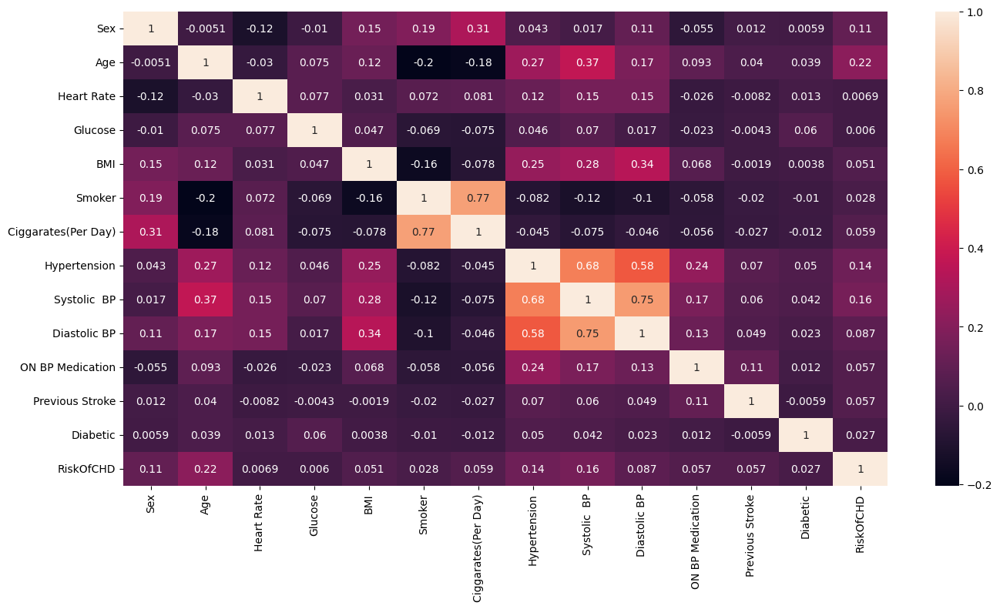

In [52]:
corr = df.corr()
plt.figure(figsize=(16, 8))
sns.heatmap(corr, annot=True)

RiskOfCHD has good correlation with Age 0.22, Systolic BP 0.16 , Hypertension 0.14 and Sex 0.11 (in descending order) </br>
Systolic BP and Hypertension has correlation 0.68 </br>
Age has correlation of 0.37 with Systolic BP </br>
Age has correlation of 0.27 with Hypertension </br>
## Confused which columns to consider ???

Since we have to classify whether An individual with given parameter readings has Risk of CHD or not, we will use Classifier algortihm.

In [82]:
y=df[['RiskOfCHD']]
#X=df[['Age','Systolic  BP']]
X=df[['Age','Systolic  BP','Hypertension','Sex','Diastolic BP']]

In [83]:
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2)

In [84]:
model =DecisionTreeClassifier(criterion='entropy')
model.fit(X_train, y_train)
model

DecisionTreeClassifier(criterion='entropy')

In [85]:
dot_data = export_graphviz(model , feature_names=X_train.columns, rounded=True, proportion=False, precision=2, filled=True)
plt.figure(figsize=(30,20))
graph = pydotplus.graph_from_dot_data(dot_data)
Image(graph.create_png())

<Figure size 3000x2000 with 0 Axes>

In [86]:
y_test_pred=model.predict(X_test)

In [87]:
print('Accuracy of DST :', accuracy_score(y_test, y_test_pred))

Accuracy of DST : 0.7949080622347949


Text(58.222222222222214, 0.5, 'Truth')

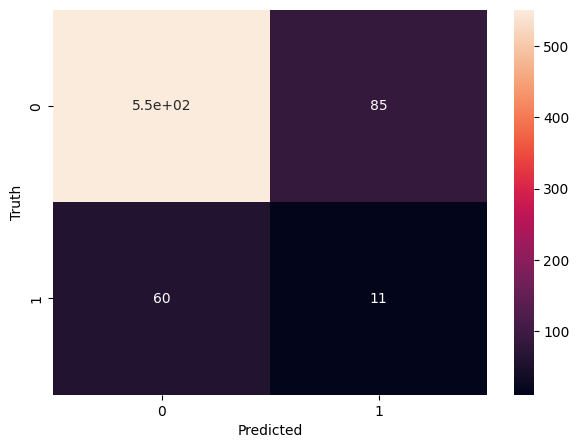

In [88]:
cm = confusion_matrix(y_test, y_test_pred)
plt.figure(figsize=(7,5))
sns.heatmap(cm,annot=True)
plt.xlabel('Predicted')
plt.ylabel('Truth')

Though the accuracy of the model is 79 %, It is very wrongly predicting the Stroke data. The high accuracy is only in No stroke data
</br>
Have tried with more feature variables but the error remains same , does not decrease, When looked at the data, found the data is not balanced, there are 3067 records with NO RiskOfCHD and 467 records with RiskOfCHD.

# Try using Random Forest

In [89]:
rf_classifier =RandomForestClassifier(n_estimators=150)
rf_classifier.fit(X_train, y_train)
rf_classifier

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


RandomForestClassifier(n_estimators=150)

In [90]:
rf_estimator=rf_classifier.estimators_[2]
dot_data = export_graphviz(rf_estimator , feature_names=X_train.columns, rounded=True, proportion=False, precision=2, filled=True)
plt.figure(figsize=(30,20))
graph = pydotplus.graph_from_dot_data(dot_data)
Image(graph.create_png())

<Figure size 3000x2000 with 0 Axes>

In [91]:
y_test_pred=rf_classifier.predict(X_test)

In [92]:
print('Accuracy of Random Forest :', accuracy_score(y_test, y_test_pred))

Accuracy of Random Forest : 0.8783592644978784


Text(58.222222222222214, 0.5, 'Truth')

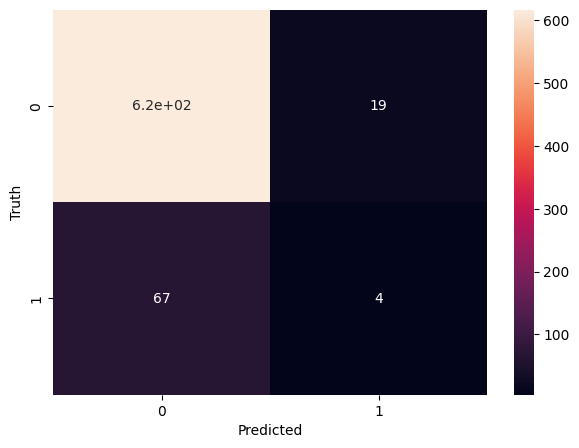

In [93]:
cm = confusion_matrix(y_test, y_test_pred)
plt.figure(figsize=(7,5))
sns.heatmap(cm,annot=True)
plt.xlabel('Predicted')
plt.ylabel('Truth')

Not much improvement, even after employing RandomForest, There are errors, so we need to balance data using SMOTE  

In [94]:
df[['RiskOfCHD']].value_counts()

,count
RiskOfCHD,
0,3067
1,467


Find minority data feature data set

In [95]:
from imblearn.over_sampling import SMOTE

In [96]:

smote = SMOTE(sampling_strategy='minority')
X_smote,y_smote=smote.fit_resample(X,y)



In [97]:
y_smote.value_counts()

,count
RiskOfCHD,
0,3067
1,3067


In [98]:
X_train,X_test,y_train,y_test=train_test_split(X_smote,y_smote,test_size=0.2)

In [99]:
dst_model =DecisionTreeClassifier(criterion='entropy')
dst_model.fit(X_train, y_train)
dst_model

DecisionTreeClassifier(criterion='entropy')

In [100]:
dot_data = export_graphviz(dst_model , feature_names=X_train.columns, rounded=True, proportion=False, precision=2, filled=True)
plt.figure(figsize=(30,20))
graph = pydotplus.graph_from_dot_data(dot_data)
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.705577 to fit



<Figure size 3000x2000 with 0 Axes>

In [101]:
y_test_pred=dst_model.predict(X_test)

In [102]:
print('Accuracy of DST :', accuracy_score(y_test, y_test_pred))

Accuracy of DST : 0.8101059494702526


[[493 110]
 [123 501]]


Text(58.222222222222214, 0.5, 'Truth')

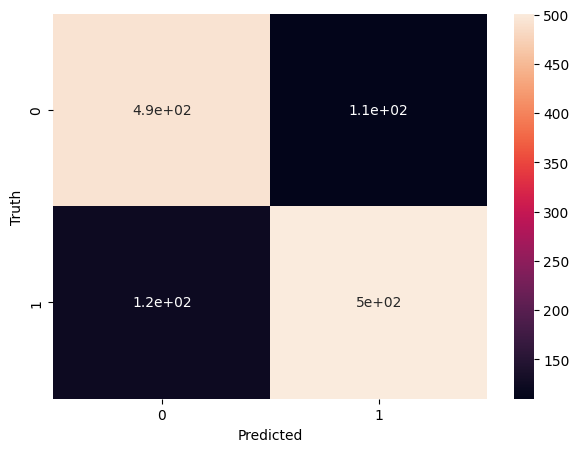

In [103]:
cm = confusion_matrix(y_test, y_test_pred)
print(cm)
plt.figure(figsize=(7,5))
sns.heatmap(cm,annot=True)
plt.xlabel('Predicted')
plt.ylabel('Truth')

In [104]:
rfc_model =RandomForestClassifier(n_estimators=150)
rfc_model.fit(X_train, y_train)
rfc_model

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


RandomForestClassifier(n_estimators=150)

In [105]:
rf_estimator=rfc_model.estimators_[2]
dot_data = export_graphviz(rf_estimator , feature_names=X_train.columns, rounded=True, proportion=False, precision=2, filled=True)
plt.figure(figsize=(30,20))
graph = pydotplus.graph_from_dot_data(dot_data)
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.693261 to fit



<Figure size 3000x2000 with 0 Axes>

In [106]:
y_test_pred=rfc_model.predict(X_test)

In [107]:
print('Accuracy of Random Forest :', accuracy_score(y_test, y_test_pred))

Accuracy of Random Forest : 0.8744906275468622


[[520  83]
 [ 71 553]]


Text(58.222222222222214, 0.5, 'Truth')

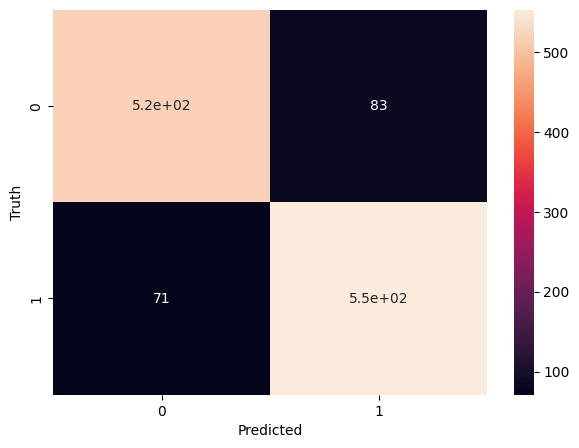

In [108]:

cm = confusion_matrix(y_test, y_test_pred)
print(cm)
plt.figure(figsize=(7,5))
sns.heatmap(cm,annot=True)
plt.xlabel('Predicted')
plt.ylabel('Truth')

With SMOTE, we balanced the data and now we can see better prediction ratio as per the confusion matrix